In [37]:
from datasets import load_dataset, DatasetDict, Dataset

ds = load_dataset("mozilla-foundation/common_voice_16_1", 'pa-IN', num_proc=4, cache_dir="common_voice_16_1")
print(ds)

/home/kd/anaconda3/envs/hf2/lib/python3.12/site-packages/datasets/load.py:1461: FutureWarning: The repository for mozilla-foundation/common_voice_16_1 contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/mozilla-foundation/common_voice_16_1
You can avoid this message in future by passing the argument `trust_remote_code=True`.
Passing `trust_remote_code=True` will be mandatory to load this dataset from the next major release of `datasets`.
  warnings.warn(


DatasetDict({
    train: Dataset({
        features: ['client_id', 'path', 'audio', 'sentence', 'up_votes', 'down_votes', 'age', 'gender', 'accent', 'locale', 'segment', 'variant'],
        num_rows: 732
    })
    validation: Dataset({
        features: ['client_id', 'path', 'audio', 'sentence', 'up_votes', 'down_votes', 'age', 'gender', 'accent', 'locale', 'segment', 'variant'],
        num_rows: 286
    })
    test: Dataset({
        features: ['client_id', 'path', 'audio', 'sentence', 'up_votes', 'down_votes', 'age', 'gender', 'accent', 'locale', 'segment', 'variant'],
        num_rows: 487
    })
    other: Dataset({
        features: ['client_id', 'path', 'audio', 'sentence', 'up_votes', 'down_votes', 'age', 'gender', 'accent', 'locale', 'segment', 'variant'],
        num_rows: 1388
    })
    invalidated: Dataset({
        features: ['client_id', 'path', 'audio', 'sentence', 'up_votes', 'down_votes', 'age', 'gender', 'accent', 'locale', 'segment', 'variant'],
        num_rows: 8

In [38]:
# we are not using other split since it represent the data samples that is not reviewed yet
# add duration column to the dataset
import os
import re
from pydub import AudioSegment
import pandas as pd

import pylab as plt

ds['train'][0]

{'client_id': '4cafbe8fbc1677fd85c367b10951916f5beccbd68f8cbb457c49f99859174a83111412f3da4d12c0e0cc3d691e81e6703595be312573237ac1c35f4ada4b21c6',
 'path': '/mnt/sea/speech_pa/common_voice_16_1/downloads/extracted/b8fef0b0cf1b21995dcd2c40a1ab66f93236aae5d3c2a005c5dbcf822b30c533/pa-IN_train_0/common_voice_pa-IN_23337849.mp3',
 'audio': {'path': '/mnt/sea/speech_pa/common_voice_16_1/downloads/extracted/b8fef0b0cf1b21995dcd2c40a1ab66f93236aae5d3c2a005c5dbcf822b30c533/pa-IN_train_0/common_voice_pa-IN_23337849.mp3',
  'array': array([0., 0., 0., ..., 0., 0., 0.]),
  'sampling_rate': 48000},
 'sentence': 'ਕਲੱਬਾਂ ਦੇ ਬੈਨਰ ਲੱਗੇ ਹੋਏ ਸਨ',
 'up_votes': 2,
 'down_votes': 0,
 'age': 'thirties',
 'gender': 'male',
 'accent': '',
 'locale': 'pa-IN',
 'segment': '',
 'variant': ''}

In [39]:
ds = ds.map(lambda x: {'path': x['path'], 'sentence': x['sentence'], 'duration': AudioSegment.from_file(x['path']).duration_seconds}, num_proc=24)

Text(0.5, 1.0, 'Audio length distribution in seconds')

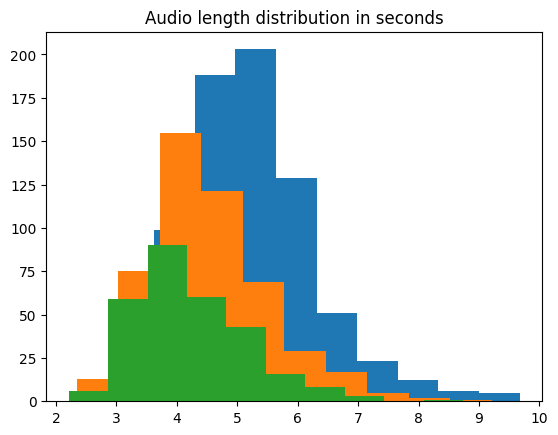

In [40]:
plt.hist(ds['train']['duration'])
plt.hist(ds['test']['duration'])
plt.hist(ds['validation']['duration'])
plt.title('Audio length distribution in seconds')

In [41]:
ds

DatasetDict({
    train: Dataset({
        features: ['client_id', 'path', 'audio', 'sentence', 'up_votes', 'down_votes', 'age', 'gender', 'accent', 'locale', 'segment', 'variant', 'duration'],
        num_rows: 732
    })
    validation: Dataset({
        features: ['client_id', 'path', 'audio', 'sentence', 'up_votes', 'down_votes', 'age', 'gender', 'accent', 'locale', 'segment', 'variant', 'duration'],
        num_rows: 286
    })
    test: Dataset({
        features: ['client_id', 'path', 'audio', 'sentence', 'up_votes', 'down_votes', 'age', 'gender', 'accent', 'locale', 'segment', 'variant', 'duration'],
        num_rows: 487
    })
    other: Dataset({
        features: ['client_id', 'path', 'audio', 'sentence', 'up_votes', 'down_votes', 'age', 'gender', 'accent', 'locale', 'segment', 'variant', 'duration'],
        num_rows: 1388
    })
    invalidated: Dataset({
        features: ['client_id', 'path', 'audio', 'sentence', 'up_votes', 'down_votes', 'age', 'gender', 'accent', 'loc

In [42]:
# rename client_id to speaker_id
ds = ds.rename_column('client_id', 'speaker_id')
# rename sentence to text
ds = ds.rename_column('sentence', 'text')
# remove audio, up_votes, down_votes, age, accent, locale, segment, variant columns
ds = ds.remove_columns(['audio', 'up_votes', 'down_votes', 'age', 'accent', 'locale', 'segment', 'variant'])



In [43]:
ds

DatasetDict({
    train: Dataset({
        features: ['speaker_id', 'path', 'text', 'gender', 'duration'],
        num_rows: 732
    })
    validation: Dataset({
        features: ['speaker_id', 'path', 'text', 'gender', 'duration'],
        num_rows: 286
    })
    test: Dataset({
        features: ['speaker_id', 'path', 'text', 'gender', 'duration'],
        num_rows: 487
    })
    other: Dataset({
        features: ['speaker_id', 'path', 'text', 'gender', 'duration'],
        num_rows: 1388
    })
    invalidated: Dataset({
        features: ['speaker_id', 'path', 'text', 'gender', 'duration'],
        num_rows: 81
    })
})

In [44]:
import random

# convert gender column if it is male then 'm' otherwise 'f'
def get_gender(x):
    if x['gender'] == 'male':
        x['gender'] = 'm'
    else:
        x['gender'] = 'f'
    return x
    
ds = ds.map(get_gender)
# rename path to audio
ds = ds.rename_column('path', 'audio')

def random_cutter(dur):
    if random.random() < 0.15:
        return dur > 30 * (random.random()*0.95+0.05)
    else:
        return dur > 30

In [45]:


train_df = ds['train'].to_pandas()

In [46]:
train_df.head(2)

,speaker_id,audio,text,gender,duration
0,4cafbe8fbc1677fd85c367b10951916f5beccbd68f8cbb...,/mnt/sea/speech_pa/common_voice_16_1/downloads...,ਕਲੱਬਾਂ ਦੇ ਬੈਨਰ ਲੱਗੇ ਹੋਏ ਸਨ,m,4.680
1,4cafbe8fbc1677fd85c367b10951916f5beccbd68f8cbb...,/mnt/sea/speech_pa/common_voice_16_1/downloads...,ਮਲਬਾ ਤਾਂ ਮੈਂ ਢੋਅ ਰਹੀ ਆਂ,m,4.488


In [47]:

import multiprocessing as mp
from tqdm import tqdm

def chunk_merger(args):
    """
    Adapted chunk_merger to use with DataFrame and duration, optimized for multiprocessing.
    """
    df, speaker_id, expanded_clips_path = args

    speaker_segments = df[df['speaker_id'] == speaker_id]
    if speaker_segments.empty:
        return []

    result = []
    expanding_row = None
    expanding_audio = None

    for index, row in tqdm(speaker_segments.iterrows(), total=len(speaker_segments), desc='Processing segments'):
        audio_path = os.path.join(row["audio"])
        audio = AudioSegment.from_file(audio_path)
        duration = audio.duration_seconds

        text = row['text'].strip()

        if expanding_row is None:
            expanding_row = row
            expanding_audio = audio
        elif random_cutter(expanding_audio.duration_seconds + duration):
            output_file_path = os.path.join(expanded_clips_path, f'{os.path.basename(audio_path)}.wav')
            expanding_audio.export(output_file_path, format='wav')
            expanding_row['duration'] = expanding_audio.duration_seconds
            expanding_row['audio'] = output_file_path
            result.append(expanding_row)
            expanding_row = row
            expanding_audio = audio
        else:
            expanding_row['text'] += ' ' + text
            expanding_audio += audio

    if expanding_row is not None and expanding_audio is not None:
        output_file_path = os.path.join(expanded_clips_path, f'{os.path.basename(expanding_row["audio"])}.wav')
        expanding_audio.export(output_file_path, format='wav')
        expanding_row['audio'] = output_file_path
        expanding_row['duration'] = expanding_audio.duration_seconds
        result.append(expanding_row)

    return result

def process_split(df, expanded_clips_path):
    """
    Processes each split using multiprocessing for speaker groups.
    """
    os.makedirs(expanded_clips_path, exist_ok=True)

    args = [(df[df['speaker_id'] == speaker_id], speaker_id, expanded_clips_path) for speaker_id in df['speaker_id'].unique()]
    pool = mp.Pool(processes=mp.cpu_count())
    results = pool.map(chunk_merger, args)
    pool.close()
    pool.join()

    merged_segments = [item for sublist in results for item in sublist]  # Flatten the list
    return pd.DataFrame(merged_segments)

results = process_split(train_df, '/mnt/sea/speech_pa/common_voice_16_1/expanded_clips/')


Processing segments: 100%|██████████| 732/732 [01:51<00:00,  6.58it/s]


In [48]:
results.shape

(166, 5)

In [49]:
results.head(2)

,speaker_id,audio,text,gender,duration
0,4cafbe8fbc1677fd85c367b10951916f5beccbd68f8cbb...,/mnt/sea/speech_pa/common_voice_16_1/expanded_...,ਕਲੱਬਾਂ ਦੇ ਬੈਨਰ ਲੱਗੇ ਹੋਏ ਸਨ ਮਲਬਾ ਤਾਂ ਮੈਂ ਢੋਅ ਰਹ...,m,24.816
5,4cafbe8fbc1677fd85c367b10951916f5beccbd68f8cbb...,/mnt/sea/speech_pa/common_voice_16_1/expanded_...,ਪਰ ਫਿਰ ਸਭ ਆਮ ਹੋ ਜਾਵੇਗਾ ਅਫ਼ਗਾਨਿਸਤਾਨ ਪ੍ਰਸ਼ਾਸਨ ਵਲ...,m,18.000


In [50]:
ds['test'][0]

{'speaker_id': '1e39be142512f97eacfd8345062805205ae7173daef7429c75b9dc7695b6cf0fe622446d4de9b4beb6f5112c77e70d5714ce1460c35c2bc1e3689da561378a7e',
 'audio': '/mnt/sea/speech_pa/common_voice_16_1/downloads/extracted/bee658d9bb7d1415ad3f839db4005be461efae5ccdb41ca632866457e613e18d/pa-IN_test_0/common_voice_pa-IN_25244497.mp3',
 'text': 'ਬਾਬੇ ਦੀ ਸ਼ੋਹਰਤ ਸਾਰੀ ਦੁਨੀਆ ਵਿੱਚ ਫੈਲ ਗਈ',
 'gender': 'f',
 'duration': 5.22}

In [51]:
from datasets import Audio

dsr = DatasetDict({
    'train': Dataset.from_pandas(results.reset_index(drop=True)),
    'test': ds['test'],
    'validation': ds['validation']
    }
)

dsr = dsr.cast_column('audio', Audio(sampling_rate=16000))

dsr.save_to_disk('/mnt/data/Speech Dataset/processed_datasets/Common_Voice_16_1_pa-IN_ASR/')

Saving the dataset (0/1 shards):   0%|          | 0/166 [00:00<?, ? examples/s]

Saving the dataset (0/1 shards):   0%|          | 0/487 [00:00<?, ? examples/s]

Saving the dataset (0/1 shards):   0%|          | 0/286 [00:00<?, ? examples/s]

In [52]:
dsr['train'][0]

{'speaker_id': '4cafbe8fbc1677fd85c367b10951916f5beccbd68f8cbb457c49f99859174a83111412f3da4d12c0e0cc3d691e81e6703595be312573237ac1c35f4ada4b21c6',
 'audio': {'path': '/mnt/sea/speech_pa/common_voice_16_1/expanded_clips/common_voice_pa-IN_23337854.mp3.wav',
  'array': array([ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
         -9.96745075e-06, -2.69398151e-06, -2.52299942e-05]),
  'sampling_rate': 16000},
 'text': 'ਕਲੱਬਾਂ ਦੇ ਬੈਨਰ ਲੱਗੇ ਹੋਏ ਸਨ ਮਲਬਾ ਤਾਂ ਮੈਂ ਢੋਅ ਰਹੀ ਆਂ ਉਹ ਪਟਿਆਲਾ ਟਾਈਗਰਜ਼ ਵੱਲੋਂ ਹਾਕੀ ਵੀ ਖੇਡਦਾ ਸੀ ਇਸ ਦੇ ਬੱਤੀ ਅੱਖਰ ਹੁੰਦੇ ਹਨ ਇਸ ਇੰਟਰਵਿਊ ਤੋਂ ਸਪੱਸ਼ਟ ਹੋ ਜਾਂਦਾ ਹੈ',
 'gender': 'm',
 'duration': 24.816}

In [53]:
dsr

DatasetDict({
    train: Dataset({
        features: ['speaker_id', 'audio', 'text', 'gender', 'duration'],
        num_rows: 166
    })
    test: Dataset({
        features: ['speaker_id', 'audio', 'text', 'gender', 'duration'],
        num_rows: 487
    })
    validation: Dataset({
        features: ['speaker_id', 'audio', 'text', 'gender', 'duration'],
        num_rows: 286
    })
})

In [54]:


from datasets import load_from_disk

ds = load_from_disk('/mnt/data/Speech Dataset/processed_datasets/Common_Voice_16_1_pa-IN_ASR/')
ds

DatasetDict({
    train: Dataset({
        features: ['speaker_id', 'audio', 'text', 'gender', 'duration'],
        num_rows: 166
    })
    test: Dataset({
        features: ['speaker_id', 'audio', 'text', 'gender', 'duration'],
        num_rows: 487
    })
    validation: Dataset({
        features: ['speaker_id', 'audio', 'text', 'gender', 'duration'],
        num_rows: 286
    })
})

In [55]:
import IPython.display as ipd
from IPython.display import Audio

durations = ds['train']['duration']
# get indexes of 20 longest audio files
indexes = sorted(range(len(durations)), key=lambda x: durations[x], reverse=True)[:20]
text = ds['train']['text']
indexes = sorted(range(len(text)), key=lambda x: len(text[x]), reverse=True)[:20]
print(indexes)
ds_check = ds['train'].select(indexes)

def display_audio(row):
    print(row['text'])
    return Audio(row['audio']['array'], rate=16000, autoplay=True)
# sort by length of text
for i in range(20):
    r = display_audio(ds_check[i])
    ipd.display(r)

[27, 22, 24, 36, 21, 15, 26, 8, 39, 125, 153, 10, 11, 30, 44, 4, 9, 133, 42, 7]
ਪਹਿਲਾਂ ਇਹਨਾਂ ਨੂੰ ਬੁਲਾ ਨਿੱਕੇ ਮੋਟੇ ਤਾਂ ਨਿਬੇੜੀਏ ਜਿੰਨ੍ਹਾ ਨੂੰ ਬਚਾਵਣ ਖਾਤਿਰ ਘੱਲਿਆ ਬਾਪੂ ਦਿੱਲੀ ਨੂੰ ਬੱਚਿਆ ਤੋਂ ਮੱਲੋ ਮੱਲੀ ਚਾਚਾ ਅਖਵਾਈਦਾ ਸੀ ਦੂਜਾ ਸਾਨੂੰ ਅਮਰੀਕਨ ਮਾਡਲ ਲਾਗੂ ਕਰਨਾ ਪਵੇਗਾ ਇਹ ਉਹਨਾਂ ਦੀ ਵੀਂ ਯਾਤਰਾ ਹੋਵੇਗੀ ਉਨ੍ਹਾਂ ਨੂੰ ਚੰਗੀਆਂ ਆਦਤਾਂ ਸਿਖਾਉਣੀਆਂ ਹਨ


ਕੁਝ ਲੋਕ ਗੱਲਾਂ ਸੁਣਨ ਦੇ ਆਦੀ ਪਿਆਰ ਤੋਂ ਬਿਨਾ ਇਹ ਰਿਸ਼ਤਾ ਮੁੱਕ ਜਾਂਦਾ ਹੈ ਖੜ੍ਹੇ ਪੈਰ ਵਿਆਹ ਕਰ ਦਿੰਦੇ ਹਨ ਕਬੱਡੀ ਵੇਖੇ ਬਿਨਾਂ ਉਹਤੋਂ ਰਹਿ ਨਹੀਂ ਹੁੰਦਾ ਤਾਏ ਨੇ ਸ਼ੀਤੇ ਨੂੰ ਸਮਝਾਉਂਦਿਆਂ ਕਿਹਾ ਧੰਨ ਦੌਲਤ ਦਾ ਹੁੰਦਾ ਵਸਾਹ ਕੋਈ ਨਹੀਂ ਔਰਤ ਦੇ ਜਮਾਂ ਥੱਲੇ ਲੱਗੇ ਹੋਏ ਹਨ


ਕੁਝ ਪ੍ਰਾਹੁਣਿਆਂ ਨੇ ਹੱਥ ਹਿਲਾ ਕੇ ਸੁਆਗਤ ਕੀਤਾ ਨੂੰ ਛੇ ਵਿਕਟਾਂ ਦੇ ਨਾਲ ਹਰਾ ਦਿੱਤਾ ਉਸ ਦੀ ਲੋਕਤੰਤਰ ਪ੍ਰਤੀ ਆਸਥਾ ਵਧੀ ਹੈ ਉਹ ਤਾਂ ਸ਼ਤਰੰਜ ਦੀ ਖੇਡ ਵਿੱਚ ਇਕ ਮਾਮੂਲੀ ਪਿਆਦਾ ਹੀ ਸੀ ਸਾਂਝੇ ਯਤਨਾਂ ਨਾਲ ਭਵਿੱਖ ਦੀਆਂ ਚੁਣੌਤੀਆਂ ਨੂੰ ਅਸਾਨੀ ਨਾਲ ਨਜਿੱਠਿਆ ਜਾ ਸਕੇਗਾ


ਐਲਡੀਐਫ਼ ਨੂੰ ਕੇਵਲ ਸੀਟਾਂ ਹੀ ਮਿਲਣਗੀਆਂ ਜਾਨੀ ਕਿ ਰੁਪੈ ਦਾ ਇਕ ਸਮੋਸਾ ਅੱਧੇ ਨਿਸ਼ਾਨ ਸਹਿਬ ਕੋਲ ਮੱਥਾਂ ਟੇਕ ਦਿੰਦੀ ਅੱਲ੍ਹਾ ਤੇ ਯਕੀਨ ਨਾ ਕਰਨ ਵਾਲੇ ਅਧਰਮੀ ਹਨ ਸਾਰੀਆਂ ਮਾਸਪੇਸ਼ੀਆਂ ਹੱਡੀਆਂ ਨਾਲ ਜੁੜੀਆਂ ਹੁੰਦੀਆਂ ਹਨ ਰਾਜਸ ਤਾਮਸ ਸਾਤਿਗ ਤੀਨੰਯੂ ਇਹ ਤੇਰੀ ਸਭ ਮਾਇਆ


ਉਨ੍ਹਾਂ ਵਿਚਕਾਰ ਸਹੀ ਤਾਲਮੇਲ ਨਹੀਂ ਸੀ ਪੈਸੇ ਨਸ਼ੇ ਡੋਡੇ ਅਫ਼ੀਮਾਂ ਵੰਡੀਆਂ ਜਾਂਦੀਆਂ ਹਨ ਘਰ ਵਿੱਚ ਕੁਰਲਾਹਟ ਮੱਚਿਆ ਹੋਇਆ ਸੀ ਸ਼ੈਡੇਂਲੀਅਰ ਈਅਰਰਿੰਗਸ ਫਾਨੂਸਾਂ ਵਰਗੇ ਝੁਮਕੇ ਇਸ ਨੂੰ ਭੋਜਨ ਤੋਂ ਬਾਅਦ ਖਾਣਾ ਚਾਹੀਦਾ ਹੈ ਦਾੜ੍ਹੀ ਦਾ ਕੋਈਕੋਈ ਵਾਲ ਹਾਲੇ ਵੀ ਕਾਲਾ ਸੀ


ਮੈਂ ਆਪਣੇ ਫੋਨ ਬਾਰੇ ਬੜਾ ਸੰਜੀਦਾ ਹਾਂ ਮਸ਼ਹੂਰੀ ਉਹਦੀ ਵੀ ਬਹੁਤ ਹੋਈ ਸੀ ਹੁਣ ਮੈਂ ਤਬਦੀਲ ਹੋਇਆ ਬਲਵਿੰਦਰ ਹਾਂ ਮੈਂ ਖੁਦ ਨੂੰ ਫਿੱਟ ਰੱਖਣ ਲਈ ਸਾਈਕਲ ਚਲਾਉਂਦਾ ਹਾਂ ਹਕੀਮਾਂ ਡਾਕਟਰਾਂ ਵੈਦਾਂ ਤੋਂ ਉਹ ਪਿੱਛਾ ਛੁਡਾਉਂਦੈ ਜੋ ਮੈਂ ਕਿਸੇ ਪਾਰਟੀ ਦਾ ਨਾਮ ਨਹੀਂ ਲੈਣਾ


ਮੰਦਰਾਂ ਤੇ ਠਾਕਰ ਦੁਆਰਿਆਂ ਚ ਪਾਠ ਪੂਜਾ ਕੀਤੀ ਜਾਂਦੀ ਹੈ ਸੌ ਸਾਲ ਤੋਂ ਟੱਪਿਆ ਜੁੱਸਾ ਏਨੀਆਂ ਦੌੜਾਂ ਲਾ ਕੇ ਵੀ ਥੱਕਿਆ ਨਹੀਂ ਤੁਣਕਾ ਪਿਆਰ ਦਾ ਵਿਚ ਸਰਦੂਲ ਸਿਕੰਦਰ ਹਾਲਾਂਕਿ ਰਾਜਪਾਲ ਰੌਡਰਿਗਜ਼ ਨੇ ਕੰਪਨੀ ਦੀ ਚੇਅਰਮੈਨੀ ਤੋਂ ਅੱਜ ਹੀ ਸਭ ਤੋਂ ਬੇਹਤਰ ਦਿਨ ਹੈ


ਦੋ ਰੋਜ਼ਾ ਸਾਹਿਤ ਸਿਰਜਨ ਮੁਕਾਬਲੇ ਕਰਵਾਏ ਸਤਿਗੁਰ ਵਾਲਾ ਮੁਖਤ ਹਮੇਸ਼ਾ ਜੀ ਸਤਿਗੁਰ ਆਵੇ ਜਾਵੇ ਉਹ ਚਾਰੇ ਅੱਠੇ ਅਹਿਲ ਮੂਰਤੀਆਂ ਬਣੇ ਬੈਠੇ ਹਨ ਹਾਰ ਸ਼ਿੰਗਾਰ ਔਰਤ ਦਾ ਗਹਿਣਾ ਮੰਨਿਆ ਜਾਂਦਾ ਹੈ ਸਾਡੇ ਨਾਲ ਵੀ ਇੰਜ ਹੀ ਹੋਇਆ ਉਹ ਹੈ ਪੰਜ ਕਕਾਰਾਂ ਦਾ ਧਾਰਨੀ ਹੋਣਾ


ਉਹ ਸਾਰੇ ਹੀ ਪਿੰਡ ਦੀ ਹਮਦਰਦ ਸੀ ਉਨ੍ਹਾਂ ਦੀ ਸ਼ਾਂਤੀ ਬਹੁਤ ਡੂੰਘੀ ਹੈ ਉਹਨਾਂ ਨੂੰ ਡਾਂਸ ਬੀਟ ਜ਼ਿਆਦਾ ਉਭਰਵੀਂ ਪਸੰਦ ਹੈ ਮਿਲਣ ਵਿਛੜਣ ਦੇ ਰੰਗਾਂ ਦੀ ਕਸੀਦਾਕਾਰੀ ਜੀੜਨ ਦੀ ਰੰਗੀਨਤਾ ਸੂਬੇ ਦੀ ਕਚਹਿਰੀ ਜਾ ਫ਼ਤਹਿ ਉਹ ਬੁਲਾਈ ਸੀ ਗੁਰੂ ਦੀ ਸੇਵਾ ਕਰਨੀ ਔਖੀ


ਟਿਕਟਾਂ ਵੀ ਹੁਣ ਸੇਲ ਤੇ ਹਨ ਬਸੋ ਮਧਿ ਚਮਕੌਰ ਕੇ ਗੁਰ ਅਪਨੀ ਕਿਰਪਾ ਧਾਰਿ ਸ਼ਹਿਰ ਦੀ ਸ਼ਾਮ ਮੇਰੀ ਸ਼ਾਮ ਨਹੀਂ ਵੇਖਦੇ ਵੇਖਦੇ ਨੌਕਰੀਆਂ ਵੀ ਠੇਕੇ ਦੀਆਂ ਹੋ ਗਈਆਂ ਬਲੀ ਸਿੰਘ ਮੁੜ ਮੁੜ ਪਿੱਛੇ ਦੇਖਦਾ ਸੀ ਸ਼ਹਿਰਾਂ ਨਾਲੋਂ ਪਿੰਡਾਂ ਵਿੱਚ ਵੱਧ ਵੋਟਾਂ ਭੁਗਤੀਆਂ


ਹੁਣ ਕਰੜੇ ਕੰਮ ਧੰਦੇ ਛੁੱਟ ਗਏ ਹਨ ਬਣ ਗਏ ਨੇ ਆਪ ਚਮਚੇ ਚਮਚੇ ਬਨਾਉਣ ਵਾਲੇ ਐਸੀ ਹੁੰਦੀ ਖੱਜਲ ਖੁਆਰੀ ਕੀ ਹੁਣ ਕਰੀਏ ਚਾਰਾ ਜੀ ਬੜੀ ਟ੍ਰਾਂਸਪੇਰੈਂਟ ਨਾਈਸ ਅਤੇ ਨੌਟੀ ਅਸੀਂ ਆਖਿਆ ਕਿ ਅੱਜ ਸਾਡਾ ਟੈੱਸਟ ਹੈ ਸਰੀਰ ਦੀ ਕਮਿਸਟਰੀ ਨੂੰ ਸੰਤੁਲਤ ਕਰਦੀ ਹੈ


ਪੁਲਿਸ ਉਸਨੂੰ ਥਾਣੇ ਲਿਆਵੇਗੀ ਸਵਾਲ ਜਵਾਬ ਕਰੇਗੀ ਸ਼ੱਕ ਸਭ ਸੁਪਨਿਆਂ ਨੂੰ ਚਕਨਾਚੂਰ ਕਰ ਦਿੰਦਾ ਹੈ ਆਪੇ ਪਹਿਰਾ ਦੇਵੋ ਆਪਣੀਆਂ ਗਲੀਆਂ ਵਿਚ ਕੇਵਲ ਇਹ ਘੜੀ ਆਖਰੀ ਤੁਹਾਡੀ ਹੈ ਜ਼ਿੰਦਗੀ ਯੂੰ ਹੀ ਤਮਾਮ ਹੋਤੀ ਹੈ ਅੱਧਾ ਭਰਿਆ ਘੜਾ ਹੀ ਆਵਾਜ਼ ਕਰਦਾ ਹੈ


ਅੰਕ ਤੇ ਫਿਰ ਹੋ ਗਏ ਭਾਲ਼ ਚ ਤਾਂ ਉਹ ਵੀ ਸੀ ਮੈਨੂੰ ਰੋਟੀ ਦੇ ਪੈਸੇ ਵੀ ਨਾ ਦੇਣ ਦਿੱਤੇ ਉਹਦੀਆਂ ਕਾਹਲੀਆਂ ਅੱਗ ਮਚਾਈ ਜਾਂਦੀਆਂ ਸਨ ਇਕ ਜੱਟ ਦੇ ਚਾਰ ਪੁੱਤ ਸਨ ਗੁਰਵਿੰਦਰ ਸਿੰਘ ਦੀ ਇਹ ਪਹਿਲੀ ਫਿਲਮ ਹੈ ਰਾਜਨੀਤੀ ਜੋੜ ਤੋੜ ਅਤੇ ਤਾਕਤ ਦੀ ਖੇਡ ਹੈ


ਕਦੇ ਕਦੇ ਲਗਦਾ ਕਿ ਹਟ ਚਲੀ ਹੈ ਪਰ ਹਫਤੇ ਬਾਅਦ ਫਿਰ ਉਹੀ ਹਾਲ ਮਾੜੀਆਂ ਸੋਚਾਂ ਲਾਲਚ ਛੱਡੀਏ ਕਮਲਾ ਮੇਰੇ ਉੱਪਰ ਝਿੱਲੀ ਪਾ ਦਿੰਦੀ ਹੈ ਉਨ੍ਹਾਂ ਦਾ ਵੀ ਹੈੱਡਕੁਆਰਟਰ ਰਿਸ਼ੀਕੇਸ਼ ਬਣਿਆ ਕੋਈ ਉਹਨਾਂ ਨੂੰ ਕਾਕਾ ਠਹਿਰੋ ਅੱਗੇ ਨਾ ਜਾਣਾ’’ ਕਹਿ ਰਿਹਾ ਸੀ


ਬੇਸੁਰ ਹੋਈ ਕੋਈ ਰਬਾਬ ਹਾਂ ਸਾਨੂੰ ਤਾਂ ਕਸ਼ਮੀਰ ਦੀਆਂ ਗਰਾਊਂਡ ਨਿਊਜ਼ ਚਾਹੀਦੀਆਂ ਹਨ ਫੁੱਲਾਂ ਦੇ ਇਹ ਪੌਦੇ ਵੱਡੇ ਹੋਏ ਡਾਕਟਰ ਅਨੁਸਾਰ ਅਪਰੇਸ਼ਨ ਸਫਲ ਹੋਇਆ ਹੈ ਇਹਨਾਂ ਕਿਹੜੈ ਮੈਨੂੰ ਗਾਲੀ ਦਿੱਤੀ ਐ ਸਿਰਫ਼ ਸਾਡੇ ਹੀਰੋ ਹੀ ਆਪਣੇ ਰੇਟ ਵਧਾਉਂਦੇ ਹਨ


ਕੋਠੇ ਤੇ ਚੜ੍ਹਦੇ ਚੰਦ ਨੂੰ ਸਿੱਖ ਕੌੰਮ ਨੂੰ ਜਗਾਉਣਾ ਕੋਈ ਮੁਸ਼ਕਲ ਨਹੀਂ ਉਸ ਨੇ ਵੱਖ ਵੱਖ ਥਾਵਾਂ ਤੇ ਫੋਟੋਆਂ ਲਈਆਂ ਸਵੈ ਮੰਥਨ ਯਥਾਰਥਵਾਦ ਵੱਲ ਲੈ ਜਾਂਦਾ ਹੈ ਮਾਂਪਿਆਂ ਨੇ ਰਿਸ਼ਤਾਂ ਕਬੂਲ ਕਰ ਲਿਆ ਕੰਮਕਾਰ ਦੇ ਮਿਆਰਾਂ ਬਾਰੇ ਜਾਣਕਾਰੀ ਵੀ ਦੇਵੇ


ਖਾਧ ਪਦਾਰਥਾਂ ਦੀ ਸਟੋਰੇਜ ਲਈ ਖਾਸ ਵੈਗਨ ਗੁਲਾਮ ਕੌਮ ਨੂੰ ਅਜ਼ਾਦੀ ਦਾ ਨਿੱਘ ਦੇ ਕੇ ਫਿਰ ਵੀ ਉਹ ਸਵੇਰੇ ਜਲਦੀ ਹੀ ਉੱਠ ਗਈ ਕਿਤਾਬਾਂ ਨੂੰ ਕੁਫਰ ਦੱਸਿਆ ਜਾ ਰਿਹਾ ਹੈ ਸੈਂਕੜੇ ਟਰਾਫੀਆਂ ਮਹਿਮਾਨਾਂ ਦੇ ਮਾਣ ਸਨਮਾਨ ਦੱਖਣ ਵਿਚ ਸ੍ਰੀ ਲੰਕਾ ਤੱਕ ਗਏ


ਇਹ ਸਲਾਹ ਗ੍ਰਹਿ ਵਿਭਾਗ ਵਲੋਂ ਆਈ ਹੈ ਉਸ ਦਾ ਵਿਕਾਸਵਾਦ ਦਾ ਸਿਧਾਂਤ ਪ੍ਰਸਿੱਧ ਸਿਧਾਂਤ ਹੈ ਉਹ ਇਸ ਵਿਚ ਆਪਣੀ ਸ਼ਾਨ ਸਮਝਦੀਆਂ ਹਨ ਜਿਹੜੇ ਅੱਡੀਆਂ ਚੱਕ ਕੇ ਫਾਹਾ ਲੈਂਦੇ ਹਨ ਇਨ੍ਹਾਂ ਸਵਾਲਾਂ ਦੇ ਕੋਈ ਜਵਾਬ ਨਹੀਂ ਹਨ ਦੇ ਰਾਹ ਵੱਲ ਵਧ ਰਿਹਾ ਹੈ


ਮੈਂ ਤਾਂ ਪੰਜਾਬੀ ਵਿਚ ਹੀ ਲਿਖਾਂਗਾ ਪ੍ਰਾਚੀਨ ਕਾਲ ਵਿਚ ਪਾਨ ਨੂੰ ਲਿਪਸਟਿਕ ਦੀ ਤਰ੍ਹਾਂ ਲਗਾਇਆ ਜਾਂਦਾ ਸੀ ਉਨ੍ਹਾਂ ਨੂੰ ਧੀ ਦਾ ਕੋਈ ਥਹੁ ਪਤਾ ਨਹੀਂ ਲੱਗਦਾ ਸਾਧ ਜੀ ਬੜੀ ਕਰਨੀ ਵਾਲੇ ਹਨ ਸਾਰੇ ਬੂਥਾਂ ਤੇ ਵੋਟਾਂ ਈ ਵੀ ਐਮ ਰਾਹੀਂ ਪੈਣਗੀਆਂ


ਸਰਬੋ ਉਪਰ ਤੂਈਉਂ ਤੂੰ ਹੈ ਤੇਰੇ ਪੰਜ ਸ਼ਬਦ ਸਰਕਾਰੀ ਸਾਧਾਰਨ ਤੌਰ ਤੇ ਗੱਲਬਾਤ ਕਰ ਰਿਹਾ ਸੀ ਸੇਵਾ ਸਾਧ ਨ ਜਾਨਿਆ ਹਰਿ ਰਾਇਆ ਲੋਕ ਕੰਮਾਂ ਕਾਰਾਂ ਨੂੰ ਤੁਰ ਪਏ ਸਨ ਰਿਸ਼ਤਿਆਂ ਵਿੱਚ ਤਰੇੜਾਂ ਆ ਜਾਂਦੀਆਂ ਹਨ ਬਾਬਾ ਗੁਰਿੰਦਰ ਜੀ ਦੇਹ ਧਾਰੀ ਹੈ
